In [253]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
import pandas as pd
import sunpy
import sunpy.map
from sunpy.coordinates import (get_earth, get_horizons_coord,
                                Helioprojective, propagate_with_solar_surface)
import sunkit_image
import sunkit_image.coalignment as coalignment
import astropy
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
import astropy.units as u
import astropy.constants as const
from astropy.io import fits
import eispac
from reproject.mosaicking import find_optimal_celestial_wcs

import cmcrameri.cm as cmcm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import (AutoLocator, AutoMinorLocator, 
    FixedLocator, FixedFormatter, LogLocator, StrMethodFormatter)
from ipywidgets import interactive, widgets
from IPython.display import display, clear_output
from astropy.visualization import (AsinhStretch, LinearStretch,
        LogStretch, ImageNormalize)
import os
from sun_blinker import SunBlinker
from copy import deepcopy   


In [2]:
def plot_colorbar(im, ax, width="3%", height="100%",loc="lower left",fontsize=14,
                  bbox_to_anchor=(1.02, 0., 1, 1),orientation="vertical"):
    clb_ax = inset_axes(ax,width=width,height=height,loc=loc,
                bbox_to_anchor=bbox_to_anchor,
                 bbox_transform=ax.transAxes,
                 borderpad=0)
    clb = plt.colorbar(im,pad = 0.05,orientation=orientation,ax=ax,cax=clb_ax)
    clb_ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    clb_ax.yaxis.get_offset_text().set_fontsize(fontsize)
    clb_ax.tick_params(labelsize=fontsize)
    return clb, clb_ax

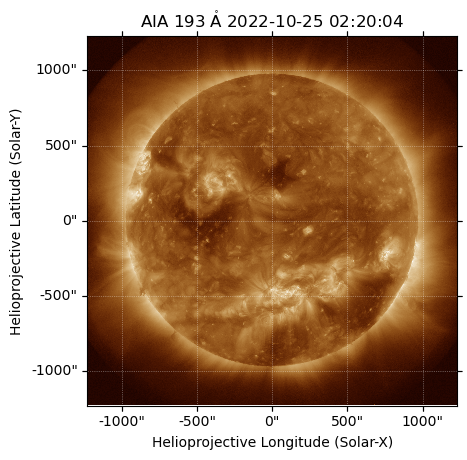

In [4]:
aia_193_map_eis = sunpy.map.Map("../../src/AIA/20221025/193/lvl15/aia.lev1_euv_12s.2022-10-25T022003Z.193.image.fits")
aia_193_map_eis.plot()

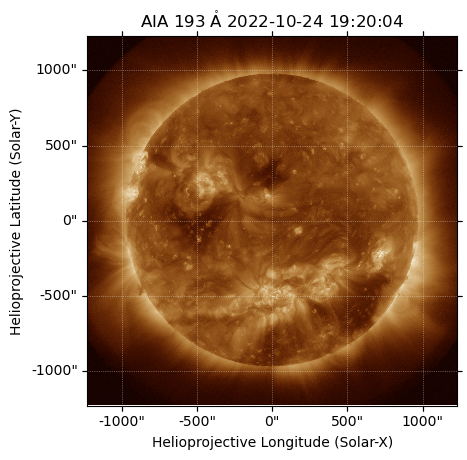

In [5]:
aia_193_map = sunpy.map.Map("../../src/AIA/20221024/193/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.193.image.fits")
aia_193_map.plot()

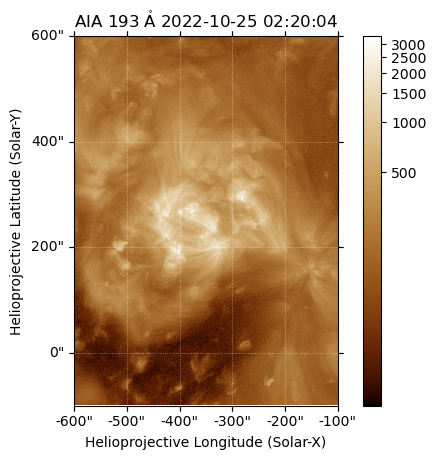

In [8]:
aia_193_map_eis_crop = aia_193_map_eis.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis.coordinate_frame))
aia_193_map_eis_crop.plot()
plt.colorbar()

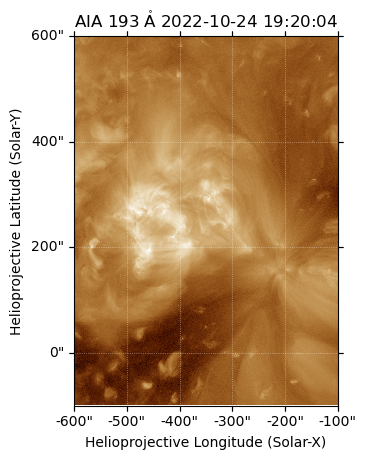

In [9]:
aia_193_map_crop = aia_193_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map.coordinate_frame))
aia_193_map_crop.plot()

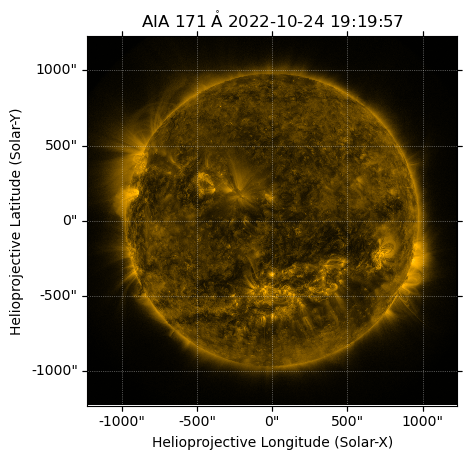

In [10]:
aia_171_map = sunpy.map.Map("../../src/AIA/20221024/171/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.171.image.fits")
aia_171_map.plot()

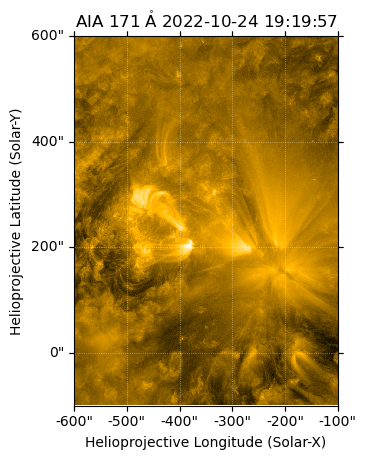

In [11]:
aia_171_map_crop = aia_171_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_171_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_171_map.coordinate_frame))
aia_171_map_crop.plot()

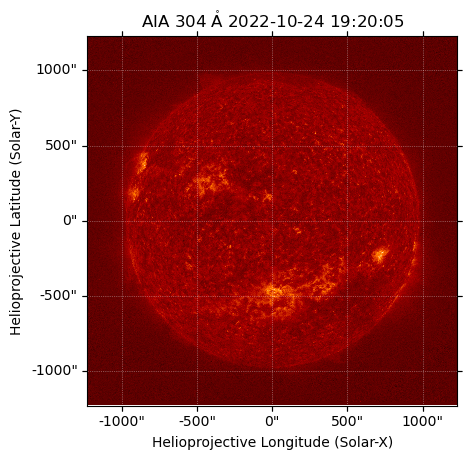

In [12]:
aia_304_map = sunpy.map.Map("../../src/AIA/20221024/304/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.304.image.fits")
aia_304_map.plot()

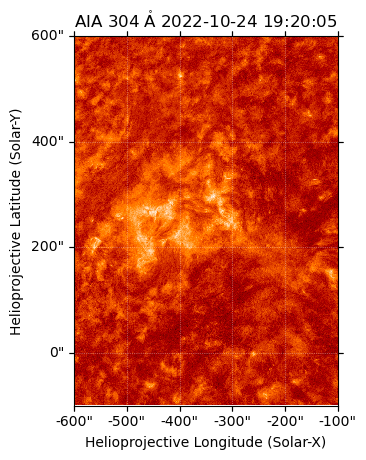

In [13]:
aia_304_map_crop = aia_304_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_304_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_304_map.coordinate_frame))
aia_304_map_crop.plot()

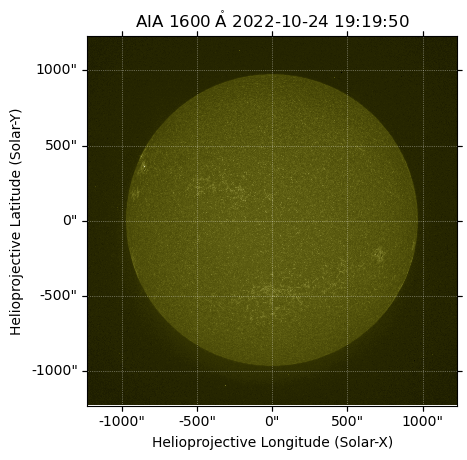

In [14]:
aia_1600_map = sunpy.map.Map("../../src/AIA/20221024/1600/lvl15/aia.lev1_uv_24s.2022-10-24T191951Z.1600.image.fits")
aia_1600_map.plot()

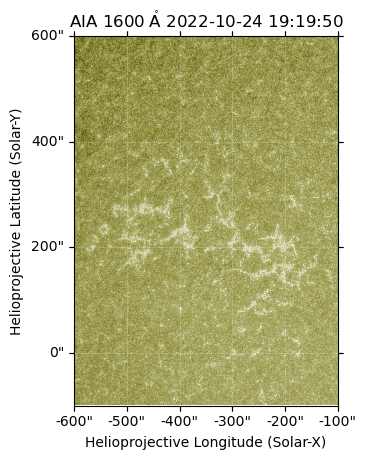

In [15]:
aia_1600_map_crop = aia_1600_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1600_map.coordinate_frame), 
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1600_map.coordinate_frame))
aia_1600_map_crop.plot()

In [18]:
SunBlinker(aia_193_map_crop,aia_171_map_crop)

In [16]:
def coalign_shift(big_map, small_map):
    yshift, xshift = coalignment._calculate_shift(big_map.data, small_map.data)
    reference_coord = big_map.pixel_to_world(xshift, yshift)
    Txshift = reference_coord.Tx - small_map.bottom_left_coord.Tx
    Tyshift = reference_coord.Ty - small_map.bottom_left_coord.Ty

    return Txshift, Tyshift
    

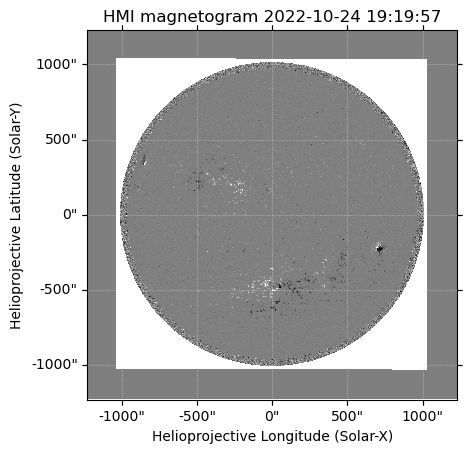

In [21]:
hmi_los_map = sunpy.map.Map("../../src/HMI/20221024/lvl15/hmi.M_45s.20221024_192100_TAI.2.magnetogram.fits")
hmi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
hmi_los_map.plot()

In [22]:
hmi_los_map_to_aia = hmi_los_map.reproject_to(aia_193_map.wcs)

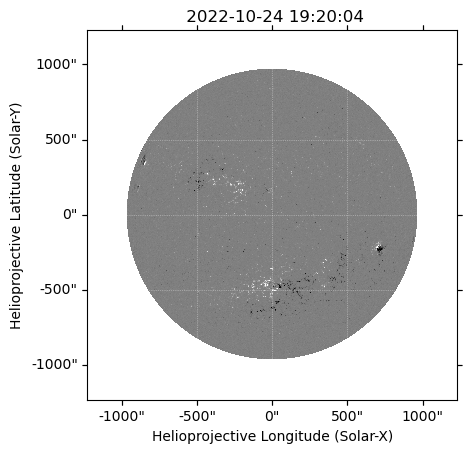

In [23]:
hmi_los_map_to_aia.plot()

In [24]:
hmi_los_map_to_aia_crop = hmi_los_map_to_aia.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame))

In [25]:
SunBlinker(aia_1600_map_crop,hmi_los_map_to_aia_crop)

For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,dsun_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


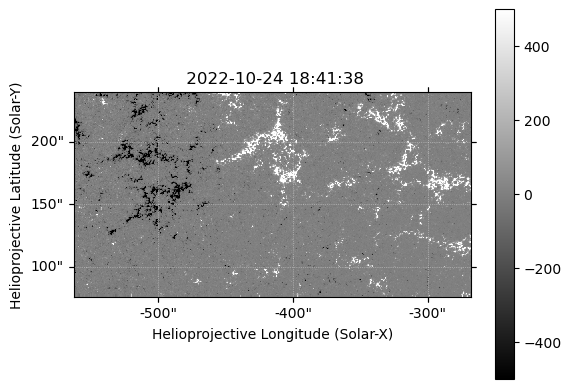

In [224]:
with fits.open("../../src/SOTSP/20221024/lvl21/20221024_184138_L2.1.fits") as hdul:
    sotsp_header = deepcopy(hdul[0].header)
    # for keys in hdul[1].header.keys():
    #     sotsp_header[keys] = hdul[1].header[keys]
    sotsp_header['CUNIT1'] = 'arcsec'
    sotsp_header['CUNIT2'] = 'arcsec'
    sotsp_header['CTYPE1'] = 'HPLN-TAN'
    sotsp_header['CTYPE2'] = 'HPLT-TAN'
    sotsp_header['CRVAL1'] = sotsp_header['XCEN']
    sotsp_header['CRVAL2'] = sotsp_header['YCEN']
    sotsp_header['CDELT1'] = sotsp_header['XSCALE']
    sotsp_header['CDELT2'] = sotsp_header['YSCALE'] 
    sotsp_header['NAXIS'] = 2
    sotsp_header['RSUN_REF'] = sotsp_header['SOLAR_RA']
    sotsp_header['DATE-OBS'] = sotsp_header['TSTART']
    sotsp_br = hdul[4].data[:]

sotsp_br_map = sunpy.map.Map(sotsp_br,sotsp_header)
sotsp_br_map.plot_settings['cmap'] = "gray"
sotsp_br_map.plot_settings['norm'] = plt.Normalize(-500, 500)
sotsp_br_map.plot()
plt.colorbar()

In [233]:
sotsp_resample_nx = (sotsp_br_map.scale.axis1 * sotsp_br_map.dimensions.x) / hmi_los_map_to_aia_crop.scale.axis1.to(u.arcsec/u.pix)
sotsp_resample_ny = (sotsp_br_map.scale.axis2 * sotsp_br_map.dimensions.y) / hmi_los_map_to_aia_crop.scale.axis2.to(u.arcsec/u.pix)
sotsp_br_map_resample = sotsp_br_map.resample(u.Quantity([sotsp_resample_nx, sotsp_resample_ny]))

In [234]:
Txshift_sotsp_hmi, Tyshift_sotsp_hmi = coalign_shift(hmi_los_map_to_aia_crop, sotsp_br_map_resample)
print(Txshift_sotsp_hmi, Tyshift_sotsp_hmi)

20.1888 arcsec 26.9726 arcsec


For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,dsun_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


In [235]:
sotsp_br_map_shift = sotsp_br_map.shift_reference_coord(Txshift_sotsp_hmi,Tyshift_sotsp_hmi)

In [244]:
with sunpy.coordinates.Helioprojective.assume_spherical_screen(sotsp_br_map_shift.observer_coordinate):
    hmi_los_map_to_aia_crop_repro_tosp = hmi_los_map_to_aia_crop.reproject_to(sotsp_br_map_shift.wcs)

In [245]:
SunBlinker(sotsp_br_map_shift,hmi_los_map_to_aia_crop_repro_tosp)

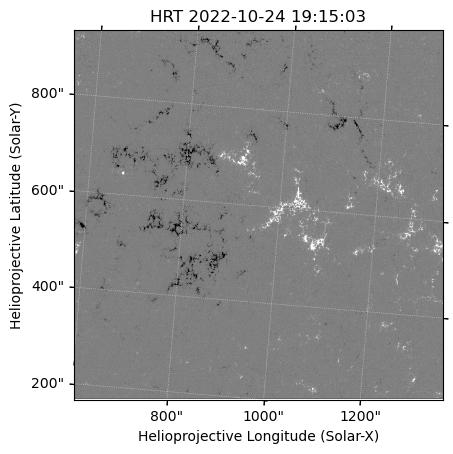

In [26]:
phi_los_map = sunpy.map.Map("../../src/PHI/20221024/solo_L2_phi-hrt-blos_20221024T191503_V01.fits")
phi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
phi_los_map.plot()

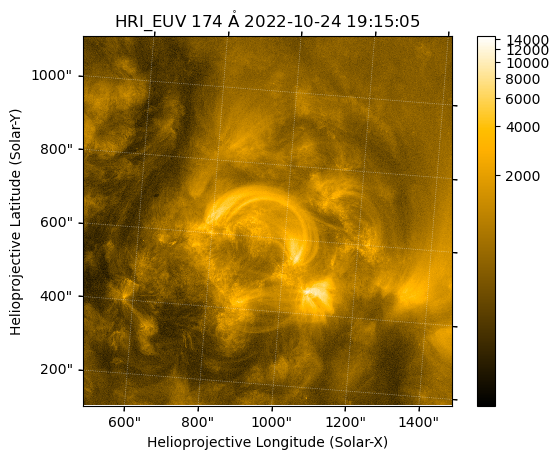

In [27]:
hri_174_map = sunpy.map.Map("../../src/EUI/HRI/euv174/20221024/solo_L2_eui-hrieuv174-image_20221024T191505172_V01.fits")
hri_174_map.plot()
plt.colorbar()

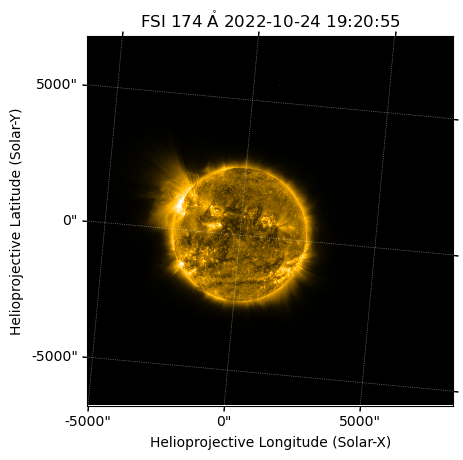

In [29]:
fsi_174_map = sunpy.map.Map("../../src/EUI/FSI/euv174/20221024/solo_L2_eui-fsi174-image_20221024T192050179_V01.fits")
fsi_174_map.plot()

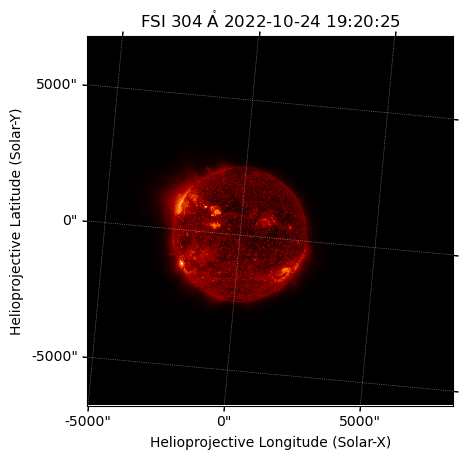

In [30]:
fsi_304_map = sunpy.map.Map("../../src/EUI/FSI/euv304/20221024/solo_L2_eui-fsi304-image_20221024T192020179_V01.fits")
fsi_304_map.plot()

Reading fit result from, 
   ../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


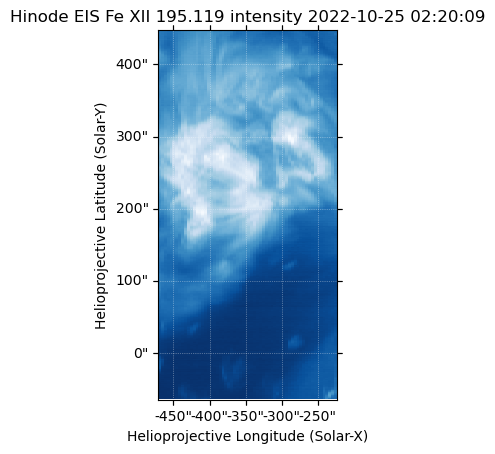

In [31]:
eis_195_fitres = eispac.read_fit("../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5")
eis_195_intmap = eis_195_fitres.get_map(component=0,measurement="intensity")
eis_195_intmap.plot()

In [32]:
aia_resample_nx = (aia_193_map_eis_crop.scale.axis1 * aia_193_map_eis_crop.dimensions.x) / eis_195_intmap.scale.axis1
aia_resample_ny = (aia_193_map_eis_crop.scale.axis2 * aia_193_map_eis_crop.dimensions.y) / eis_195_intmap.scale.axis2
aia_193_map_resample = aia_193_map_eis_crop.resample(u.Quantity([aia_resample_nx, aia_resample_ny]))

In [33]:
eis_to_aia_Txshift, eis_to_aia_Tyshift = coalign_shift(aia_193_map_resample,eis_195_intmap)
print(eis_to_aia_Txshift)
print(eis_to_aia_Tyshift)
eis_195_intmap_shift = eis_195_intmap.shift_reference_coord(eis_to_aia_Txshift,eis_to_aia_Tyshift)

3.90053 arcsec
-3.19133 arcsec


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


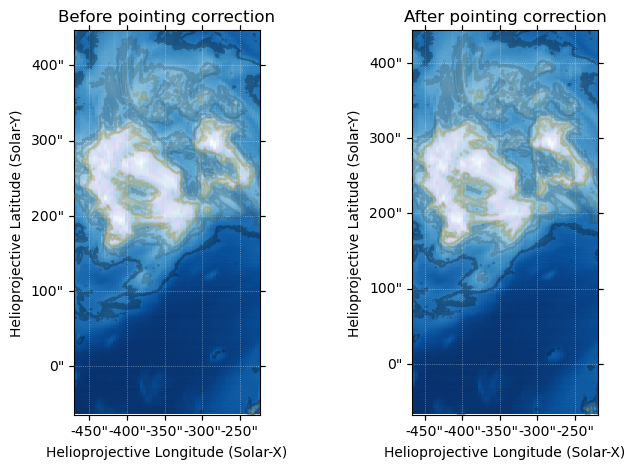

In [34]:
fig = plt.figure(figsize=(8,5))
ax1 = fig.add_subplot(121,projection=eis_195_intmap)
eis_195_intmap.plot(axes=ax1, title='Before pointing correction')

ax2 = fig.add_subplot(122,projection=eis_195_intmap_shift)
eis_195_intmap_shift.plot(axes=ax2, title='After pointing correction')

aia_levels = [200, 400, 500, 700, 800, 1200] * aia_193_map_eis.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis.draw_contours(aia_levels, axesd=ax_, cmap=cmcm.batlowK, alpha=0.3)
    ax_.axis(bounds)

In [35]:
with propagate_with_solar_surface():
    aia_193_map_eis_derot = aia_193_map_eis.reproject_to(aia_193_map.wcs)

In [36]:
aia_193_map_eis_compare = aia_193_map_eis_derot.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame))

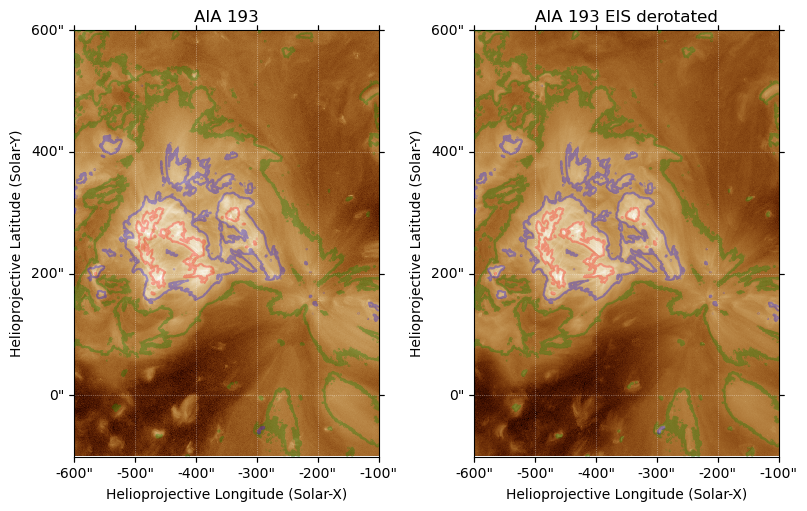

In [37]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
aia_193_map_crop.plot(axes=ax1, title='AIA 193')

ax2 = fig.add_subplot(122,projection=aia_193_map_eis_compare)
aia_193_map_eis_compare.plot(axes=ax2, title='AIA 193 EIS derotated')

aia_levels = [200, 500, 1200] 

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis_compare.draw_contours(aia_levels, axes=ax_, colors=["g","b","r"], alpha=0.3)
    ax_.axis(bounds)

In [38]:
SunBlinker(aia_193_map_crop,aia_193_map_eis_compare)

In [39]:
def derotate_fsi(fsi_map, hri_map,algorithm="adaptive"):
    out_frame = hri_map.coordinate_frame
    out_center = SkyCoord(0*u.arcsec, 0*u.arcsec, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(fsi_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(fsi_map.scale),
                                        rotation_matrix=fsi_map.rotation_matrix)
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        fsi_map_derot = fsi_map.reproject_to(out_wcs,algorithm=algorithm)

    return fsi_map_derot


In [40]:
fsi_174_map_hri_time = derotate_fsi(fsi_174_map,hri_174_map)

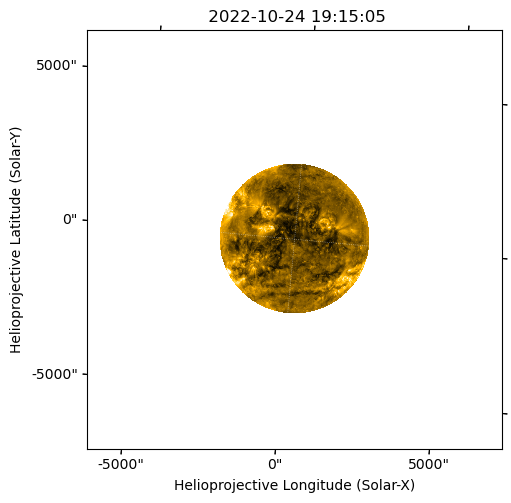

In [41]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=fsi_174_map_hri_time)
fsi_174_map_hri_time.plot()

In [65]:
fsi_174_crop = fsi_174_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame))

In [66]:
hri_174_map_rotate_to_fsi_wcs = deepcopy(hri_174_map.wcs)
hri_174_map_rotate_to_fsi_wcs.wcs.pc = fsi_174_map_hri_time.wcs.wcs.pc
hri_174_map_rotate_to_fsi_wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'HPLN-TAN' 'HPLT-TAN' 
CRVAL : 0.24672436037989 0.16925159334153 
CRPIX : 896.5 960.5 
PC1_1 PC1_2  : 0.99571519178924 -0.092473006007843 
PC2_1 PC2_2  : 0.092473006007843 0.99571519178924 
CDELT : 0.00013666666666667 0.00013666666666667 
NAXIS : 2048  2048

In [67]:
hri_174_map_correct_rot_matrix = hri_174_map.reproject_to(hri_174_map_rotate_to_fsi_wcs)

In [68]:
hri_174_map_repro = hri_174_map_correct_rot_matrix.reproject_to(fsi_174_crop.wcs)

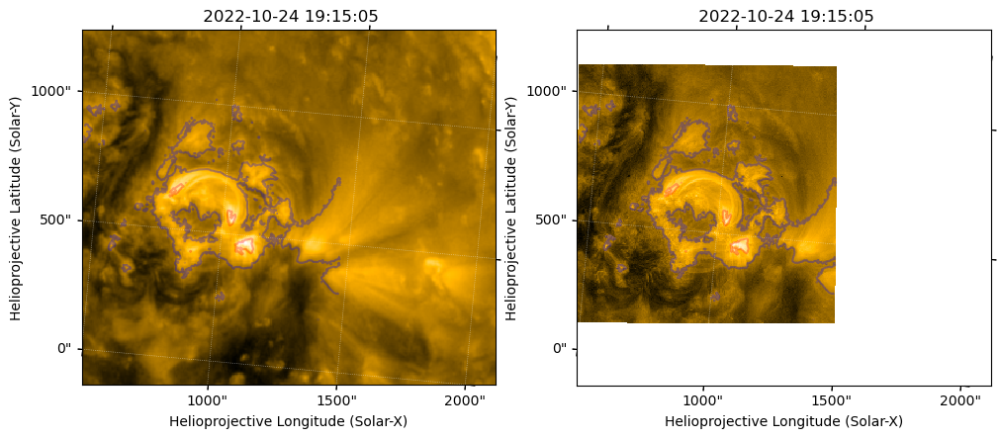

In [69]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()

ax2 = fig.add_subplot(122,projection=hri_174_map_repro)
im2 = hri_174_map_repro.plot()

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_repro.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


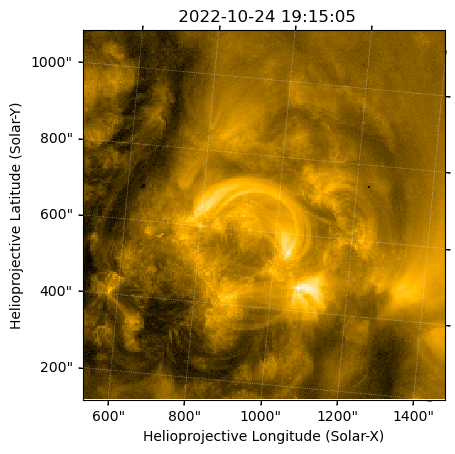

In [70]:
hri_174_map_repro_cut = hri_174_map_repro.submap([10,57]*u.pix,
                                                 top_right=[224,275]*u.pix)
hri_174_map_repro_cut.plot()

In [71]:
Txshift_hri, Tyshift_hri = coalign_shift(fsi_174_crop,hri_174_map_repro_cut)
print(Txshift_hri, Tyshift_hri)

1.63633 arcsec 7.58532 arcsec


In [75]:
hri_174_map_repro_shift = hri_174_map_repro.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_repro_cut_shift = hri_174_map_repro_cut.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_shifted = hri_174_map_correct_rot_matrix.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_shifted = hri_174_map_shifted.submap([10,10]*u.pix,
                                                    top_right=[2038,2038]*u.pix)
fsi_174_hri_fov = fsi_174_map_hri_time.reproject_to(hri_174_map_shifted.wcs)

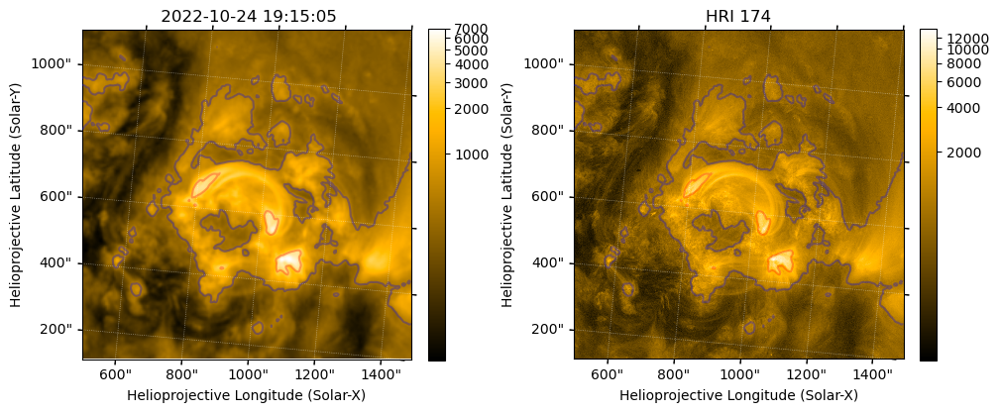

In [76]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_hri_fov)
im1 = fsi_174_hri_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
ax2.set_title("HRI 174")
plt.colorbar(ax=ax2,shrink=0.75)

fsi_174_levels = [500,3000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_174_hri_fov.draw_contours(fsi_174_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [77]:
SunBlinker(fsi_174_hri_fov, hri_174_map_shifted,figsize=(6,6))

In [79]:
fsi_304_map_hri_time = derotate_fsi(fsi_304_map,hri_174_map)

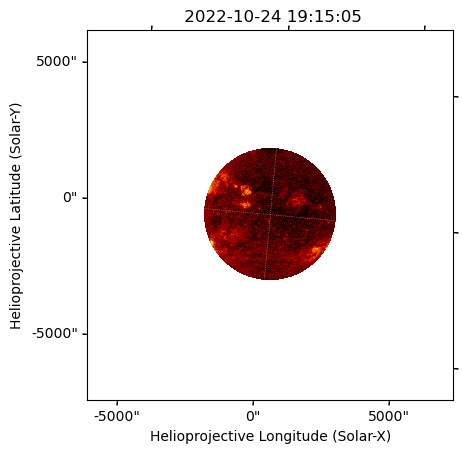

In [80]:
fsi_304_map_hri_time.plot()

In [81]:
fsi_304_crop = fsi_304_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame))

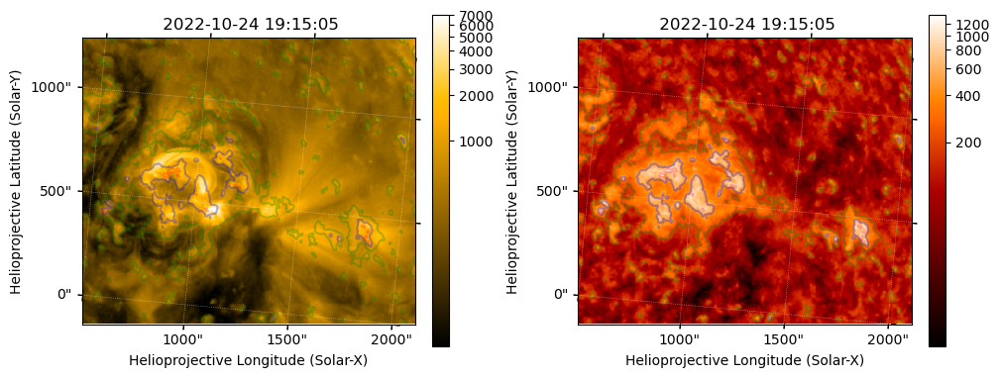

In [82]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [83]:
SunBlinker(fsi_174_crop, fsi_304_crop)

In [84]:
aia_304_map_repro = aia_304_map.reproject_to(fsi_304_crop.wcs)

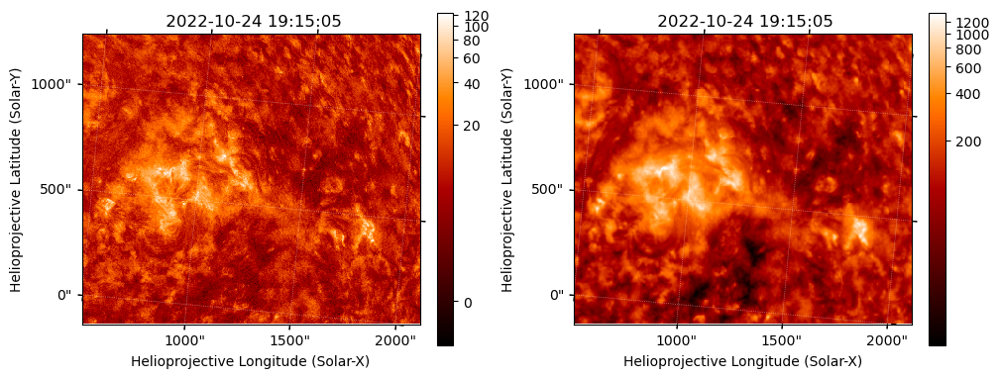

In [85]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

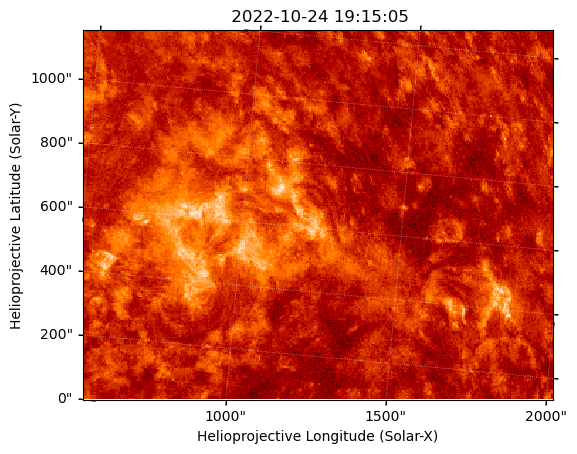

In [90]:
aia_304_map_repro_cut = aia_304_map_repro.submap([12,30]*u.pix,
                                                    top_right=[343,290]*u.pix)
aia_304_map_repro_cut.plot()

In [91]:
Txshift_aia_fsi, Tyshift_aia_fsi = coalign_shift(fsi_304_crop,aia_304_map_repro_cut)
print(Txshift_aia_fsi, Tyshift_aia_fsi)

-1.41678 arcsec 2.37726 arcsec


In [92]:
aia_304_map_repro_shift = aia_304_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

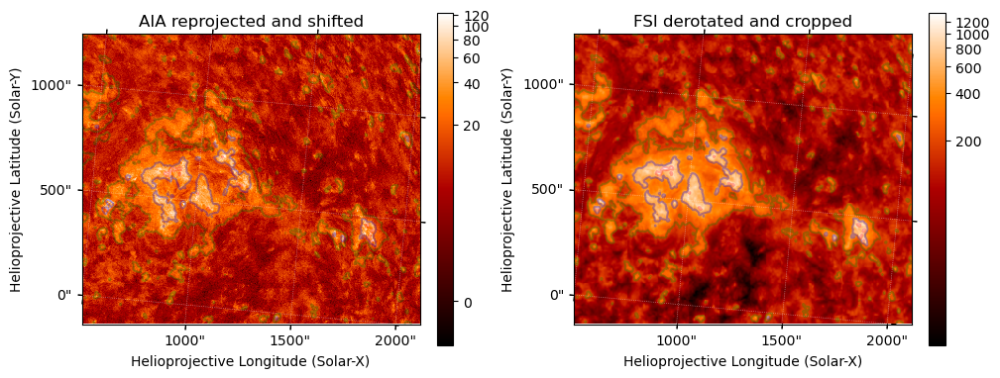

In [93]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro_shift)
im1 = aia_304_map_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [95]:
SunBlinker(aia_304_map_repro_shift, fsi_304_map_hri_time, reproject=True)

In [96]:
aia_1600_map_repro = aia_1600_map.reproject_to(fsi_304_crop.wcs)

In [97]:
aia_1600_map_repro_shift = aia_1600_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

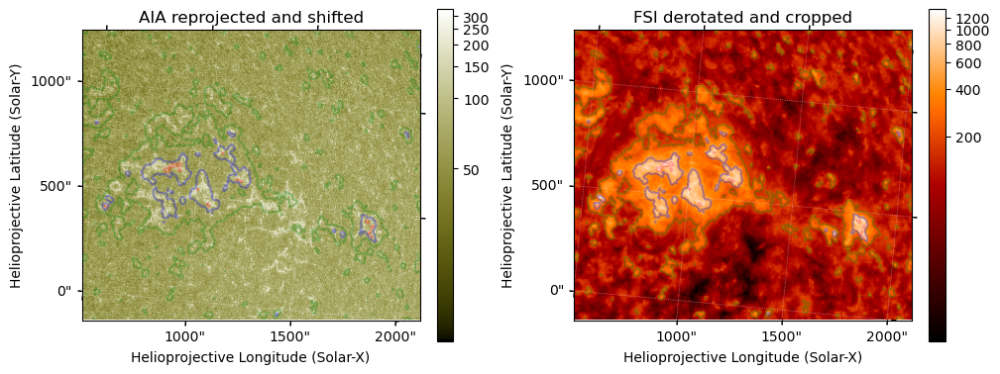

In [98]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_repro_shift)
im1 = aia_1600_map_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [99]:
SunBlinker(aia_1600_map_repro_shift, fsi_304_crop)

In [100]:
aia_171_repro = aia_171_map.reproject_to(fsi_304_crop.wcs)
aia_171_repro_shift = aia_171_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

In [102]:
aia_171_repro_shift_hrifov = aia_171_repro_shift.reproject_to(hri_174_map_shifted.wcs)

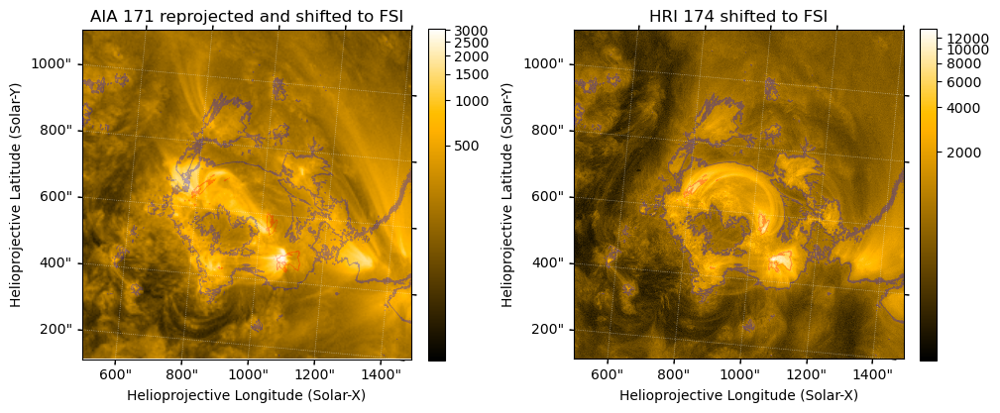

In [103]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_shift_hrifov)
im1 = aia_171_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 171 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to FSI")

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [104]:
SunBlinker(aia_171_repro_shift_hrifov, hri_174_map_shifted)

In [105]:
aia_193_repro = aia_193_map.reproject_to(fsi_304_crop.wcs)
aia_193_repro_shift = aia_193_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
aia_193_repro_shift_hrifov = aia_193_repro_shift.reproject_to(hri_174_map_shifted.wcs)

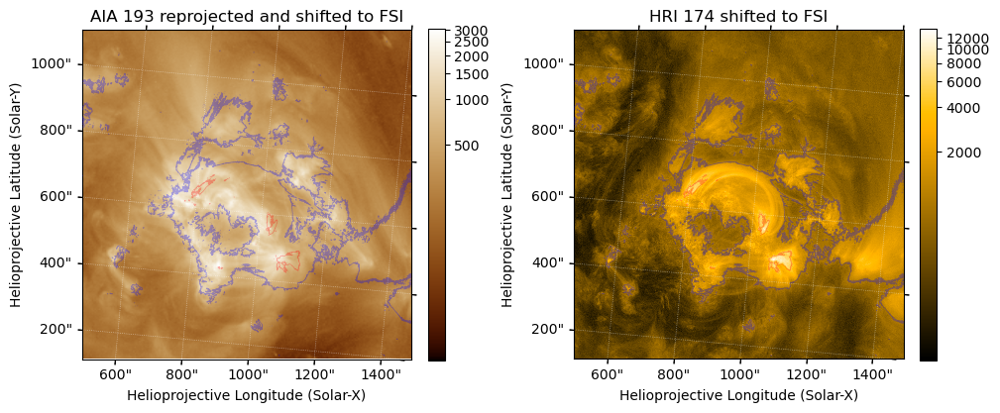

In [106]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_repro_shift_hrifov)
im1 = aia_193_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 193 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to FSI")

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [107]:
SunBlinker(aia_193_repro_shift_hrifov, hri_174_map_shifted)

In [108]:
hmi_los_map_repro = hmi_los_map_to_aia.reproject_to(fsi_304_crop.wcs)
hmi_los_map_repro_shift = hmi_los_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
hmi_los_map_repro_shift_hrifov = hmi_los_map_repro_shift.reproject_to(hri_174_map_shifted.wcs)

In [109]:
fsi_304_crop_hrifov = fsi_304_crop.reproject_to(hri_174_map_shifted.wcs)

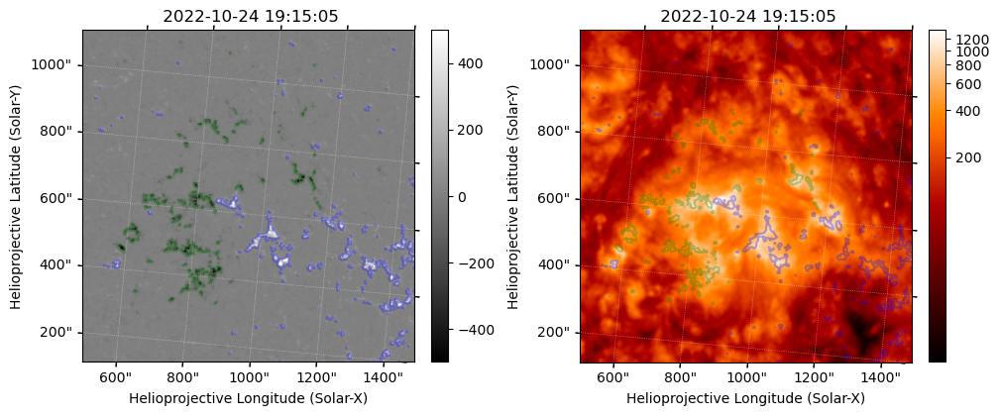

In [110]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_shift_hrifov)
im1 = hmi_los_map_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop_hrifov)
im2 = fsi_304_crop_hrifov.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)
    

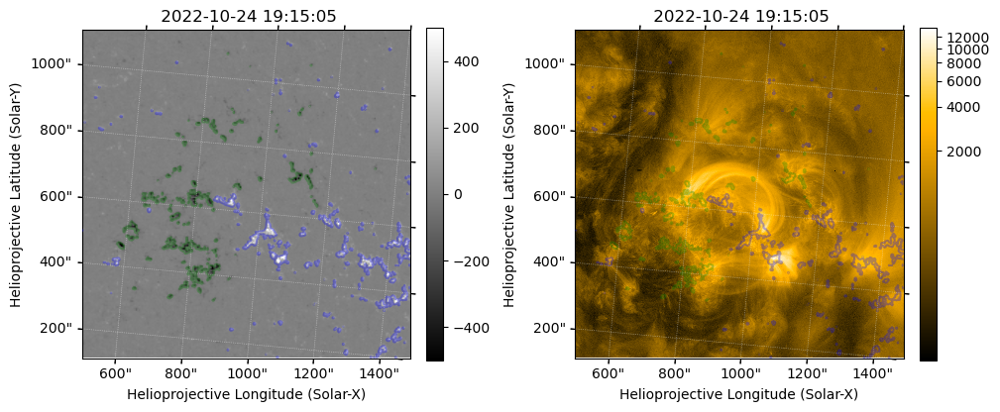

In [111]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_shift_hrifov)
im1 = hmi_los_map_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [112]:
SunBlinker(hmi_los_map_repro_shift_hrifov, hri_174_map_shifted)

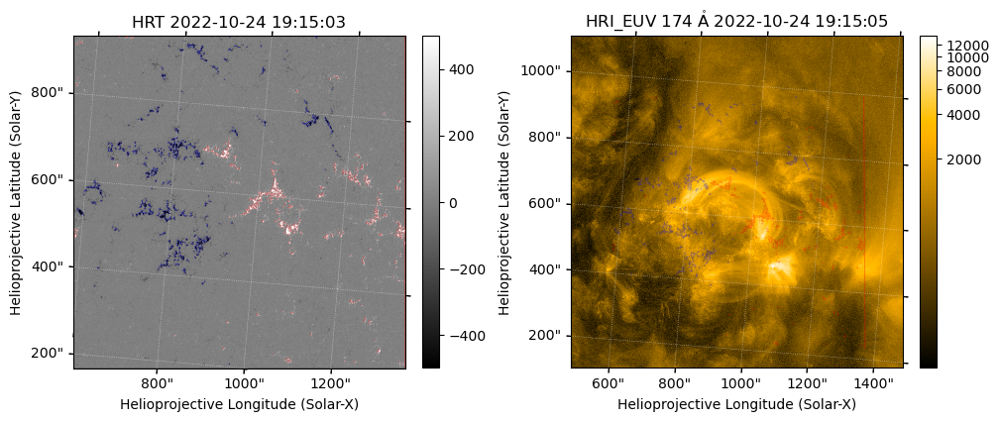

In [113]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map)
im1 = phi_los_map.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map)
im2 = hri_174_map.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

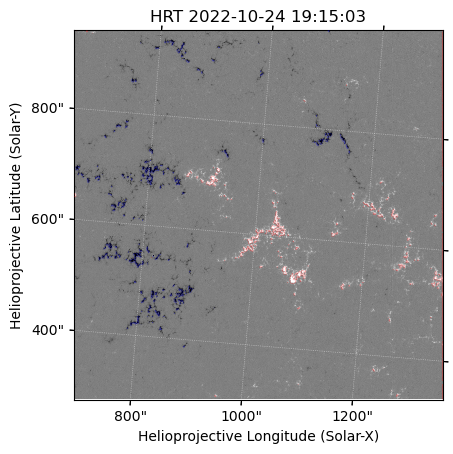

In [115]:
phi_los_map_crop = phi_los_map.submap([200,200]*u.pix,
                                      top_right=[1847,1847]*u.pix)

phi_los_map_crop.plot()
phi_los_map_crop.draw_contours([-300,300]*phi_los_map_crop.unit,colors=["b","r"], alpha=0.3,linewidths=0.5)

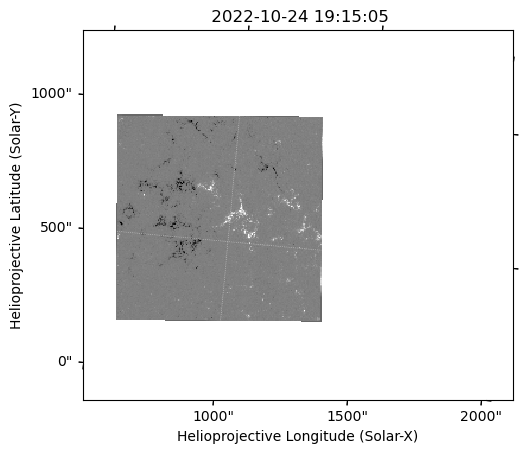

In [116]:
phi_los_map_resample = phi_los_map.reproject_to(fsi_304_crop.wcs)
phi_los_map_resample.plot()

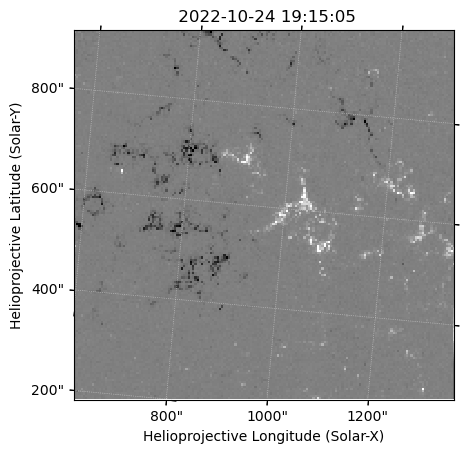

In [128]:
phi_los_map_resample_crop = phi_los_map_resample.submap([30,70]*u.pix,
                                                        top_right=[200,235]*u.pix)
phi_los_map_resample_crop.plot()

In [129]:
Txshift_phi_hmi, Tyshift_phi_hmi = coalign_shift(hmi_los_map_repro_shift,phi_los_map_resample_crop)
print(Txshift_phi_hmi, Tyshift_phi_hmi)

-9.42354 arcsec -65.4466 arcsec


In [130]:
phi_los_map_shifted = phi_los_map.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)
phi_los_map_shifted_hrifov = phi_los_map_shifted.reproject_to(hri_174_map_shifted.wcs)
phi_los_map_resample_crop_shifted = phi_los_map_resample_crop.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)

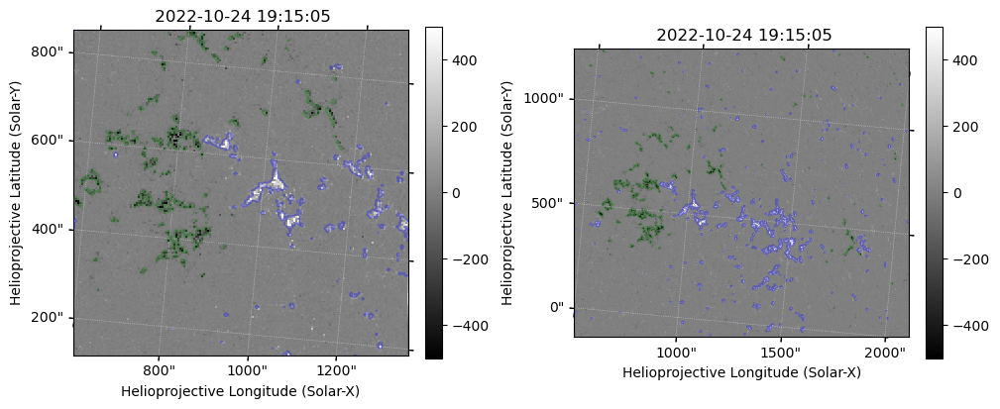

In [131]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_resample_crop_shifted)
im1 = phi_los_map_resample_crop_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro_shift)
im2 = hmi_los_map_repro_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

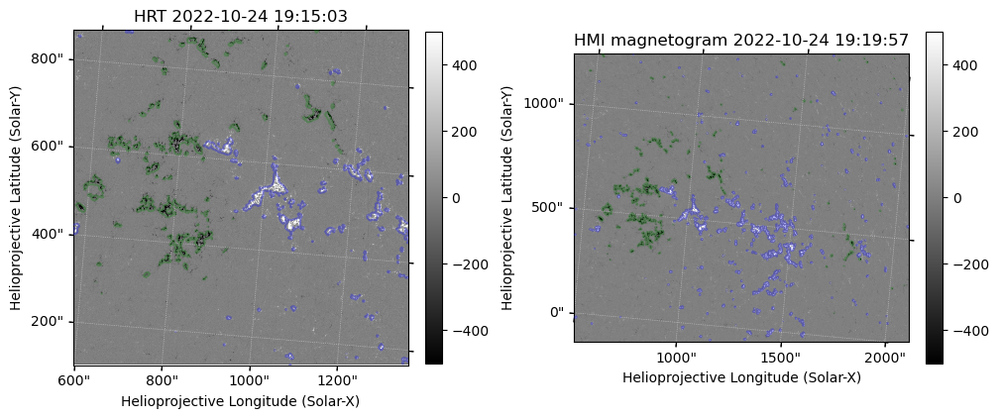

In [132]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted)
im1 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro_shift)
im2 = hmi_los_map_repro_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title(hmi_los_map.name)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

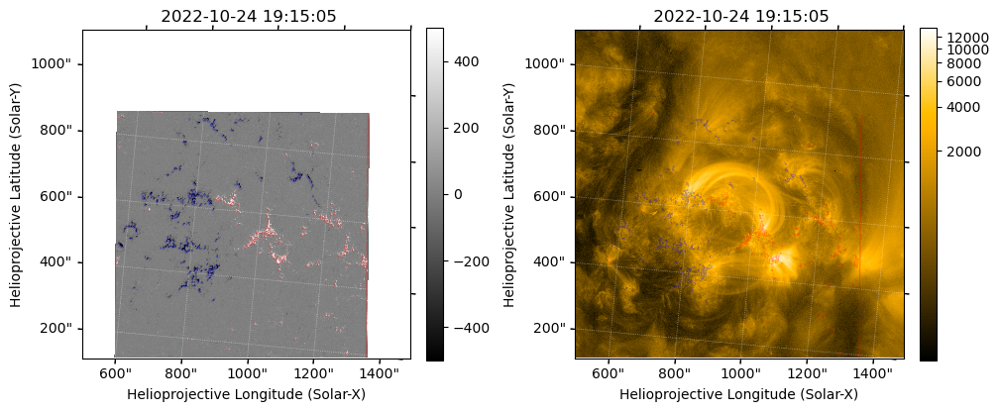

In [133]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted_hrifov)
im1 = phi_los_map_shifted_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted_hrifov.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [144]:
SunBlinker(phi_los_map_shifted_hrifov.submap([210,10]*u.pix,top_right=[1700,1500]*u.pix), 
           hmi_los_map_repro_shift_hrifov.submap([210,10]*u.pix,top_right=[1700,1500]*u.pix),
           figsize=(6,6))

In [145]:
eis_195_velmap = eis_195_fitres.get_map(component=0,measurement="vel")
eis_195_velmap_shift = eis_195_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_intmap_derot = eis_195_intmap_shift.reproject_to(aia_193_map_crop.wcs)
    eis_195_velmap_derot = eis_195_velmap_shift.reproject_to(aia_193_map_crop.wcs)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


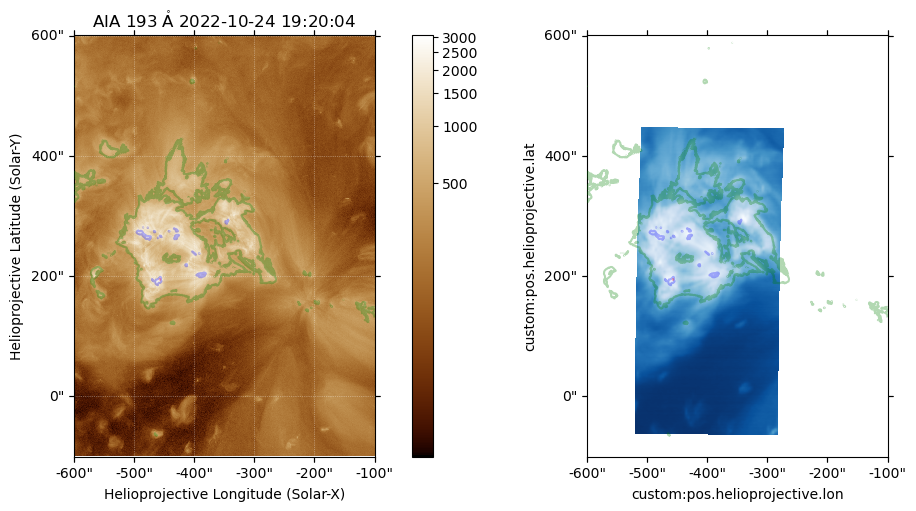

In [146]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
ax2.imshow(eis_195_intmap_derot.data,origin="lower",cmap=eis_195_intmap_derot.plot_settings['cmap'],norm=eis_195_intmap_derot.plot_settings['norm'])

aia_193_levels = [500,2000,3000]*aia_193_map_crop.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_crop.draw_contours(aia_193_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)



In [147]:
SunBlinker(aia_193_map_crop, eis_195_intmap_derot)

In [166]:
SunBlinker(aia_193_map_crop, eis_195_velmap_derot)

In [148]:
eis_195_intmap_derot_repro = eis_195_intmap_derot.reproject_to(fsi_304_crop.wcs)
eis_195_velmap_derot_repro = eis_195_velmap_derot.reproject_to(fsi_304_crop.wcs)

In [149]:
eis_195_intmap_derot_repro_shifted = eis_195_intmap_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
eis_195_velmap_derot_repro_shifted = eis_195_velmap_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

In [150]:
eis_195_intmap_derot_repro_shifted_hrifov = eis_195_intmap_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)
eis_195_velmap_derot_repro_shifted_hrifov = eis_195_velmap_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)

In [151]:
SunBlinker(hri_174_map_shifted, eis_195_intmap_derot_repro_shifted_hrifov)

In [152]:
SunBlinker(hri_174_map_shifted, eis_195_velmap_derot_repro_shifted_hrifov)

In [161]:
SunBlinker(aia_171_map_crop.submap([100,100]*u.pix,top_right=[550,900]*u.pix),
           eis_195_velmap_derot.submap([100,100]*u.pix,top_right=[550,900]*u.pix),)

/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


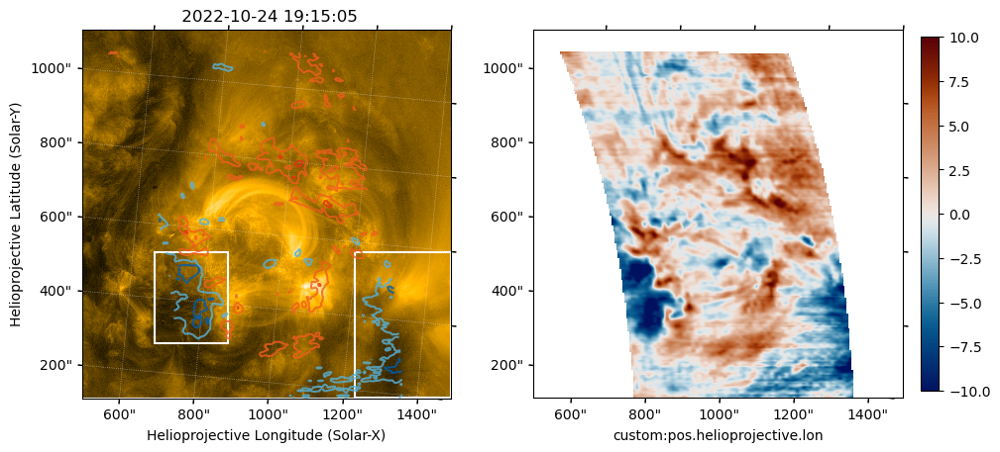

In [251]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted)
im1 = hri_174_map_shifted.plot()
ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_velmap_derot_repro_shifted_hrifov.data,vmin=-10,vmax=10,cmap=cmcm.vik,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

bounds = ax1.axis()
hri_174_map_shifted.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
hri_174_map_shifted.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [249]:
hri_174_map_shifted.data.shape

(2029, 2029)

In [163]:
eis_195_width_map = eis_195_fitres.get_map(component=0,measurement="width")
eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
eis_195_v1oe = eis_195_true_width*u.angstrom/np.sqrt(4*np.log(2))*const.c/(195.119*u.angstrom)
vth2 = 2*const.k_B*(10**6.2)*u.K/const.u/55.85
vnth = np.sqrt(eis_195_v1oe**2 - vth2).to(u.km/u.s)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


/tmp/ipykernel_1060988/4214942759.py:2: RuntimeWarning: invalid value encountered in sqrt
  eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
/home/yjzhu/.local/lib/python3.11/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


In [164]:
eis_195_vnth_map = sunpy.map.Map(vnth, eis_195_width_map.wcs)
eis_195_vnth_map_shift = eis_195_vnth_map.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_vnth_map_shift_derot = eis_195_vnth_map_shift.reproject_to(aia_193_map_crop.wcs)

eis_195_vnth_map_shift_derot_repro = eis_195_vnth_map_shift_derot.reproject_to(fsi_304_crop.wcs)
eis_195_vnth_map_shift_derot_repro_shifted = eis_195_vnth_map_shift_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
eis_195_vnth_map_shift_derot_repro_shifted_hrifov = eis_195_vnth_map_shift_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


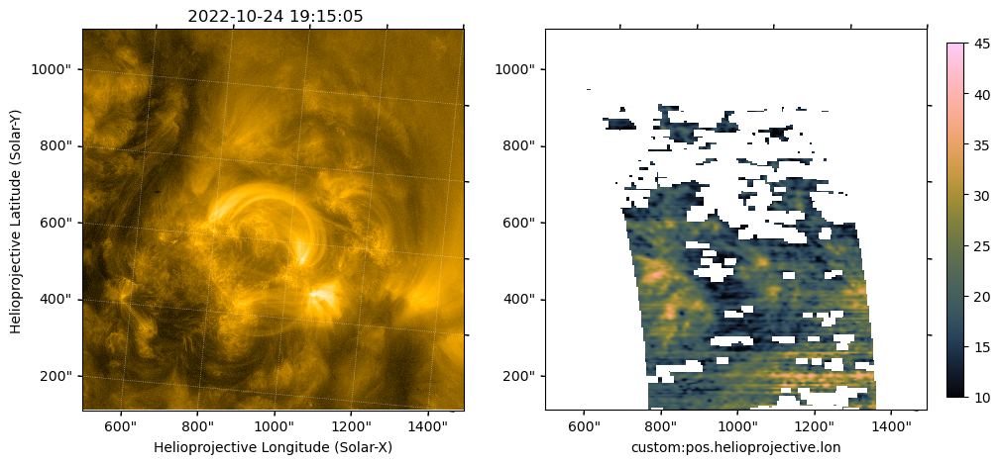

In [165]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted)
im1 = hri_174_map_shifted.plot()
# ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_vnth_map_shift_derot_repro_shifted_hrifov.data,vmin=10,vmax=45,cmap=cmcm.batlowK,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

ax2.set_ylabel(" ")

In [170]:
SunBlinker(phi_los_map_shifted_hrifov, eis_195_velmap_derot_repro_shifted_hrifov)